## Problem Statement


### Business Context

The prices of the stocks of companies listed under a global exchange are influenced by a variety of factors, with the company's financial performance, innovations and collaborations, and market sentiment being factors that play a significant role. News and media reports can rapidly affect investor perceptions and, consequently, stock prices in the highly competitive financial industry. With the sheer volume of news and opinions from a wide variety of sources, investors and financial analysts often struggle to stay updated and accurately interpret its impact on the market. As a result, investment firms need sophisticated tools to analyze market sentiment and integrate this information into their investment strategies.

### Problem Definition

With an ever-rising number of news articles and opinions, an investment startup aims to leverage artificial intelligence to address the challenge of interpreting stock-related news and its impact on stock prices. They have collected historical daily news for a specific company listed under NASDAQ, along with data on its daily stock price and trade volumes.

As a member of the Data Science and AI team in the startup, you have been tasked with analyzing the data, developing an AI-driven sentiment analysis system that will automatically process and analyze news articles to gauge market sentiment, and summarizing the news at a weekly level to enhance the accuracy of their stock price predictions and optimize investment strategies. This will empower their financial analysts with actionable insights, leading to more informed investment decisions and improved client outcomes.

### Data Dictionary

* `Date` : The date the news was released
* `News` : The content of news articles that could potentially affect the company's stock price
* `Open` : The stock price (in \$) at the beginning of the day
* `High` : The highest stock price (in \$) reached during the day
* `Low` :  The lowest stock price (in \$) reached during the day
* `Close` : The adjusted stock price (in \$) at the end of the day
* `Volume` : The number of shares traded during the day
* `Label` : The sentiment polarity of the news content
    * 1: positive
    * 0: neutral
    * -1: negative

## Please read the instructions carefully before starting the project.

**Note**: If the free-tier GPU of Google Colab is not accessible (due to unavailability or exhaustion of daily limit or other reasons), the following steps can be taken:

1. Wait for 12-24 hours until the GPU is accessible again or the daily usage limits are reset.

2. Switch to a different Google account and resume working on the project from there.

3. Try using the CPU runtime:
    - To use the CPU runtime, click on *Runtime* => *Change runtime type* => *CPU* => *Save*
    - One can also click on the *Continue without GPU* option to switch to a CPU runtime (kindly refer to the snapshot below)
    - The instructions for running the code on the CPU are provided in the respective sections of the notebook.

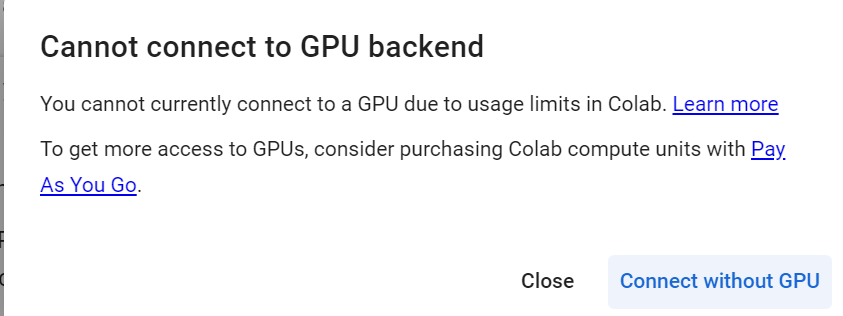

## Installing and Importing Necessary Libraries

In [ ]:
# installing the sentence-transformers and gensim libraries for word embeddings
!pip install -U sentence-transformers gensim transformers tqdm -q

In [52]:
# To manipulate and analyze data
import pandas as pd
import numpy as np

# To visualize data
import matplotlib.pyplot as plt
import seaborn as sns

# To used time-related functions
import time

# To parse JSON data
import json

# to load the natural language toolkit
import nltk
nltk.download('stopwords')    # loading the stopwords
# nltk.download('punkt')    # loading the punkt module used in tokenization
# nltk.download('omw-1.4')    # dependency for tokenization
nltk.download('wordnet')    # loading the wordnet module that is used in stemming


# To build, tune, and evaluate ML models
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier

from sklearn.model_selection import GridSearchCV
from sklearn.metrics import confusion_matrix, accuracy_score, f1_score, precision_score, recall_score

# To load/create word embeddings
from gensim.models import Word2Vec
from gensim.models import KeyedVectors
from gensim.scripts.glove2word2vec import glove2word2vec

# To work with transformer models
import torch
from sentence_transformers import SentenceTransformer

# To implement progress bar related functionalities
from tqdm import tqdm
tqdm.pandas()

# To ignore unnecessary warnings
import warnings
warnings.filterwarnings('ignore')

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/christophebuffard/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/christophebuffard/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


## Loading the dataset

In [3]:
stock_news = pd.read_csv("stock_news.csv")
df = stock_news.copy()

## Data Overview

In [4]:
df.shape

(349, 8)

In [5]:
df.head()

,Date,News,Open,High,Low,Close,Volume,Label
0,2019-01-02,The tech sector experienced a significant dec...,41.740002,42.244999,41.482498,40.246914,130672400,-1
1,2019-01-02,Apple lowered its fiscal Q1 revenue guidance ...,41.740002,42.244999,41.482498,40.246914,130672400,-1
2,2019-01-02,Apple cut its fiscal first quarter revenue fo...,41.740002,42.244999,41.482498,40.246914,130672400,-1
3,2019-01-02,This news article reports that yields on long...,41.740002,42.244999,41.482498,40.246914,130672400,-1
4,2019-01-02,Apple's revenue warning led to a decline in U...,41.740002,42.244999,41.482498,40.246914,130672400,-1


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 349 entries, 0 to 348
Data columns (total 8 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Date    349 non-null    object 
 1   News    349 non-null    object 
 2   Open    349 non-null    float64
 3   High    349 non-null    float64
 4   Low     349 non-null    float64
 5   Close   349 non-null    float64
 6   Volume  349 non-null    int64  
 7   Label   349 non-null    int64  
dtypes: float64(4), int64(2), object(2)
memory usage: 21.9+ KB


In [7]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Open,349.0,4.622923e+01,6.442817e+00,3.756750e+01,4.174000e+01,4.597500e+01,5.070750e+01,6.681750e+01
High,349.0,4.670046e+01,6.507321e+00,3.781750e+01,4.224500e+01,4.602500e+01,5.085000e+01,6.706250e+01
Low,349.0,4.574539e+01,6.391976e+00,3.730500e+01,4.148250e+01,4.564000e+01,4.977750e+01,6.586250e+01
Close,349.0,4.492632e+01,6.398338e+00,3.625413e+01,4.024691e+01,4.459692e+01,4.911079e+01,6.480523e+01
Volume,349.0,1.289482e+08,4.317031e+07,4.544800e+07,1.032720e+08,1.156272e+08,1.511252e+08,2.444392e+08
Label,349.0,-5.444126e-02,7.151192e-01,-1.000000e+00,-1.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00


In [8]:
df.columns.tolist()

['Date', 'News', 'Open', 'High', 'Low', 'Close', 'Volume', 'Label']

In [9]:
df.isnull().sum()

Date      0
News      0
Open      0
High      0
Low       0
Close     0
Volume    0
Label     0
dtype: int64

In [10]:
df.nunique()

Date       71
News      349
Open       70
High       70
Low        71
Close      71
Volume     71
Label       3
dtype: int64

In [11]:
df.duplicated().sum()

0

In [12]:
# Filter the DataFrame to show only duplicated rows
duplicated_rows = df[df.duplicated()]
print("\nDuplicated rows:")
print(duplicated_rows)


Duplicated rows:
Empty DataFrame
Columns: [Date, News, Open, High, Low, Close, Volume, Label]
Index: []


In [13]:
df.Date.info()

<class 'pandas.core.series.Series'>
RangeIndex: 349 entries, 0 to 348
Series name: Date
Non-Null Count  Dtype 
--------------  ----- 
349 non-null    object
dtypes: object(1)
memory usage: 2.9+ KB


In [14]:
df['Date'] = pd.to_datetime(df['Date'])

In [15]:
# Sort the data by date
df = df.sort_values('Date')

### Observation
* No missing value
* No duplicate data
* convert the Data column to a date/time format
* Sort the dataset around the date as it is clearly a time serie.

## Exploratory Data Analysis

### Univariate Analysis

* Distribution of individual variables
* Compute and check the distribution of the length of news content

In [16]:
# function to create labeled barplots


def labeled_barplot(data, feature, perc=False, n=None):
    """
    Barplot with percentage at the top

    data: dataframe
    feature: dataframe column
    perc: whether to display percentages instead of count (default is False)
    n: displays the top n category levels (default is None, i.e., display all levels)
    """

    total = len(data[feature])  # length of the column
    count = data[feature].nunique()
    if n is None:
        plt.figure(figsize=(count + 1, 5))
    else:
        plt.figure(figsize=(n + 1, 5))

    plt.xticks(rotation=90, fontsize=15)
    ax = sns.countplot(
        data=data,
        x=feature,
        palette="Paired",
        order=data[feature].value_counts().index[:n].sort_values(),
    )

    for p in ax.patches:
        if perc == True:
            label = "{:.1f}%".format(
                100 * p.get_height() / total
            )  # percentage of each class of the category
        else:
            label = p.get_height()  # count of each level of the category

        x = p.get_x() + p.get_width() / 2  # width of the plot
        y = p.get_height()  # height of the plot

        ax.annotate(
            label,
            (x, y),
            ha="center",
            va="center",
            size=12,
            xytext=(0, 5),
            textcoords="offset points",
        )  # annotate the percentage

    title = "Observation on " + feature
    plt.suptitle(title, fontsize=16)
    plt.show()  # show the plot

In [17]:

label = {
    1: 'positive',
    0: 'neutral',
    -1: 'negative'
}
df['Label'] = df['Label'].map(label)

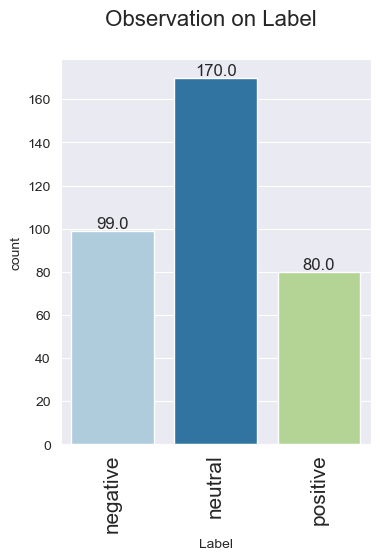

In [18]:
category_columns = df.select_dtypes("object").columns
for i in category_columns:
    labeled_barplot(df, i)

In [19]:
# function to plot a boxplot and a histogram along the same scale.


def histogram_boxplot(data, feature, figsize=(12, 7), kde=False, bins=None):
    """
    Boxplot and histogram combined

    data: dataframe
    feature: dataframe column
    figsize: size of figure (default (12,7))
    kde: whether to the show density curve (default False)
    bins: number of bins for histogram (default None)
    """
    f2, (ax_box2, ax_hist2) = plt.subplots(
        nrows=2,  # Number of rows of the subplot grid= 2
        sharex=True,  # x-axis will be shared among all subplots
        gridspec_kw={"height_ratios": (0.25, 0.75)},
        figsize=figsize,
    )  # creating the 2 subplots
    sns.boxplot(
        data=data, x=feature, ax=ax_box2, showmeans=True, color="violet"
    )  # boxplot will be created and a triangle will indicate the mean value of the column
    sns.histplot(
        data=data, x=feature, kde=kde, ax=ax_hist2, bins=bins, palette="winter"
    ) if bins else sns.histplot(
        data=data, x=feature, kde=kde, ax=ax_hist2
    )  # For histogram
    ax_hist2.axvline(
        data[feature].mean(), color="green", linestyle="--"
    )  # Add mean to the histogram
    ax_hist2.axvline(
        data[feature].median(), color="black", linestyle="-"
    )  # Add median to the histogram
    # Add the title to the figure
    title = "Observation on " + feature
    f2.suptitle(title, fontsize=16)
    plt.show()

In [20]:
### Function to plot distributions

def distribution_plot_wrt_target(data, predictor, target):
    """
    Print the distribution of the predictor per target, and for the predictor
    :param data: dataframe
    :param predictor: the predictor we want to print the distribution of
    :param target: the target we want to print
    """
    target_uniq = data[target].unique()
    n = len(target_uniq)  # Number of unique target values
    fig, axs = plt.subplots(1, n, figsize=(18, 6))  # Creates a 1xn grid of subplots

    for i in range(n):
        axs[i].set_title("Distribution of " + predictor + " for target " + target_uniq[i])
        sns.histplot(
            data=data[data[target] == target_uniq[i]],
            x=predictor,
            kde=True,
            ax=axs[i],
            color="teal",
        )
    plt.tight_layout()
    plt.show()


In [21]:
# function to plot stacked bar chart

def stacked_barplot(data, predictor, target):
    """
    Print the category counts and plot a stacked bar chart

    data: dataframe
    predictor: independent variable
    target: target variable
    """

    count = data[predictor].nunique()
    sorter = data[target].value_counts().index[-1]
    tab1 = pd.crosstab(data[predictor], data[target], margins=True).sort_values(
        by=sorter, ascending=False
    )
    print(tab1)
    print("-" * 120)
    tab = pd.crosstab(data[predictor], data[target], normalize="index").sort_values(
        by=sorter, ascending=False
    )
    tab.plot(kind="bar", stacked=True, figsize=(count + 1, 5))
    plt.legend(
        loc="lower left", frameon=False,
    )
    plt.legend(loc="upper left", bbox_to_anchor=(1, 1))
    title = "Target: " + target + " vs. Predictor: " + predictor
    plt.title(title)
    plt.show()

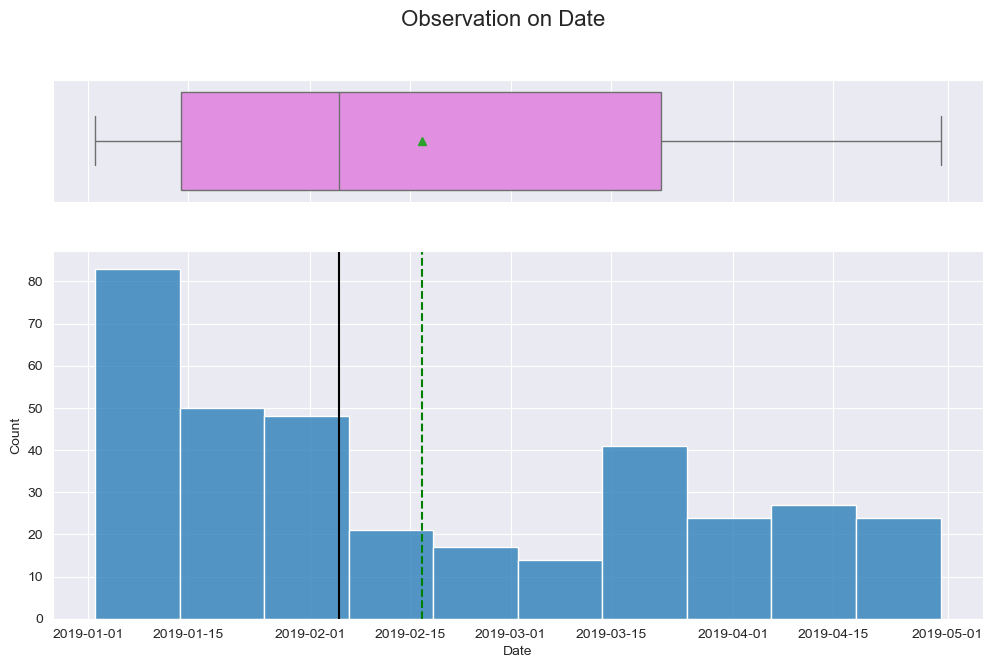

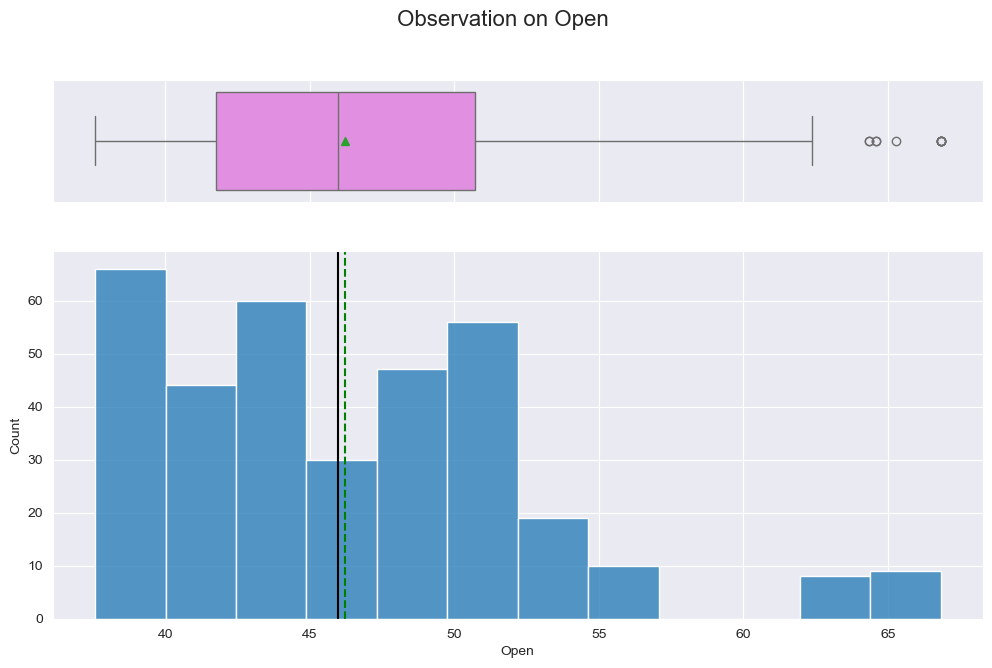

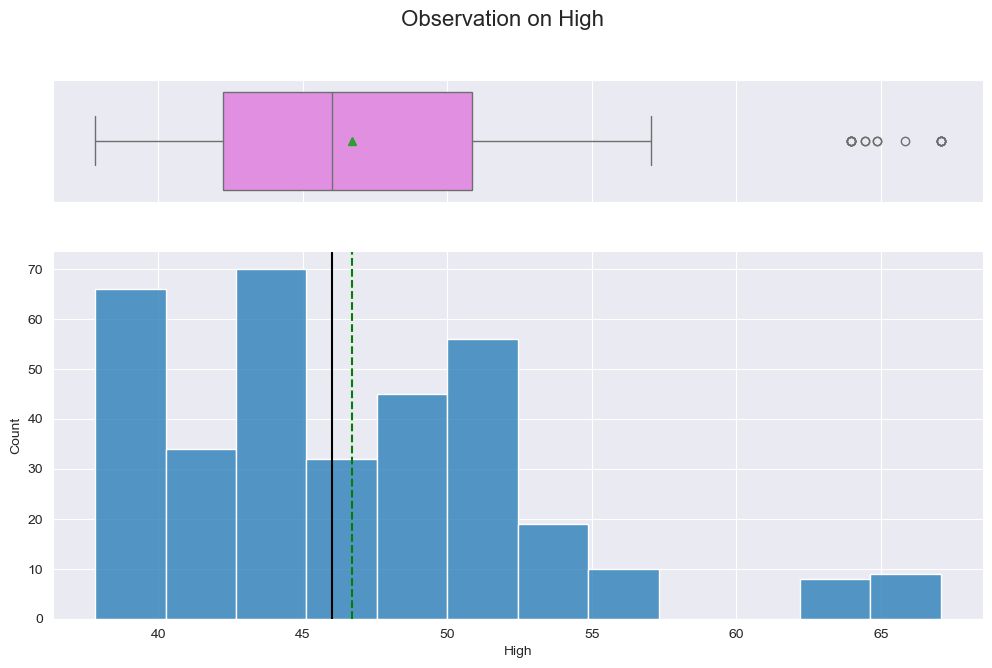

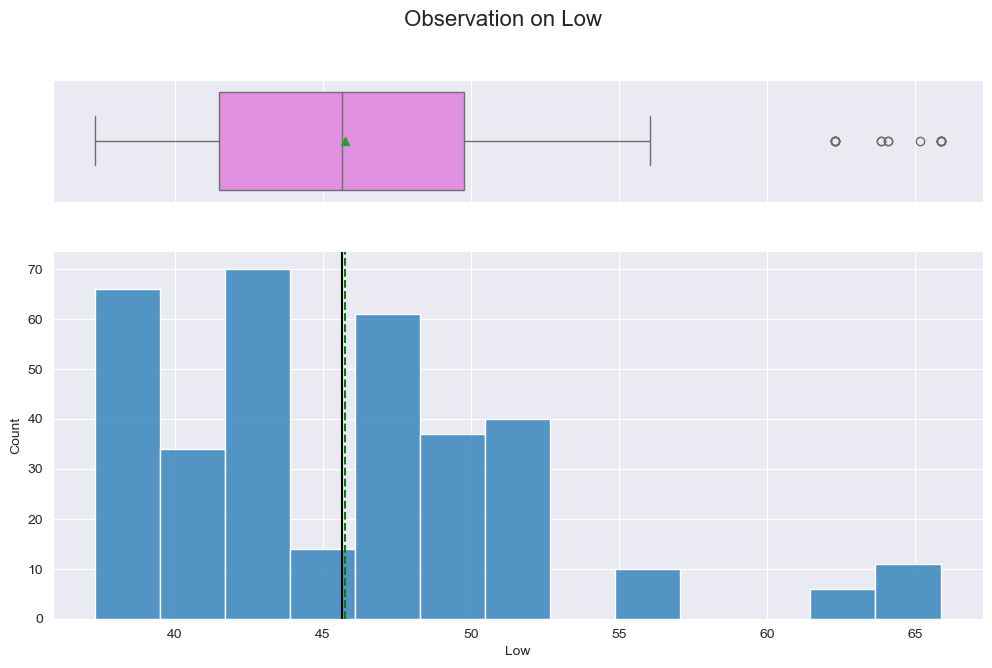

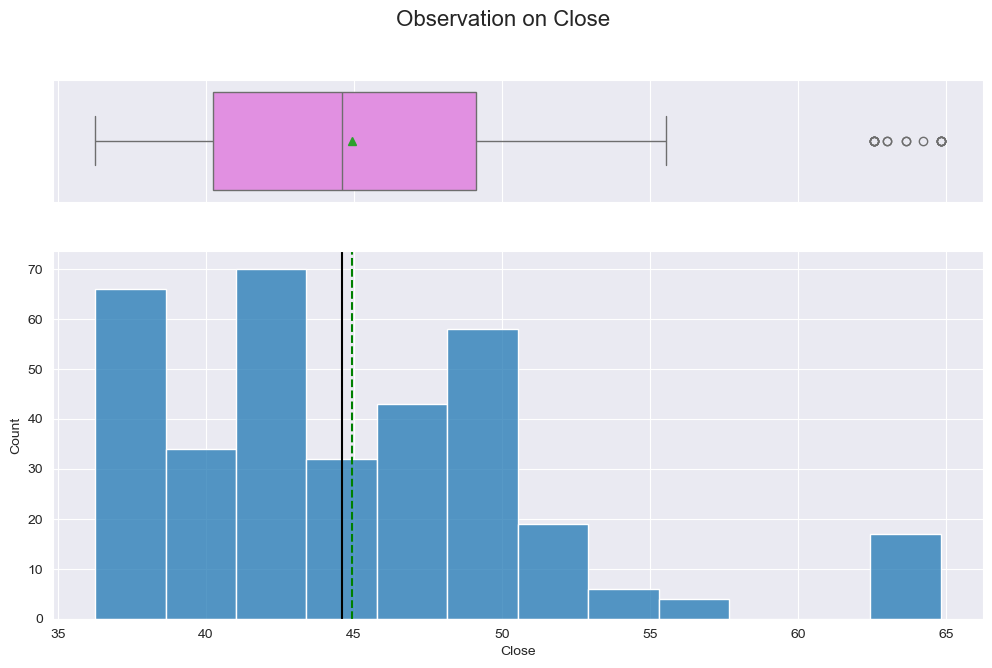

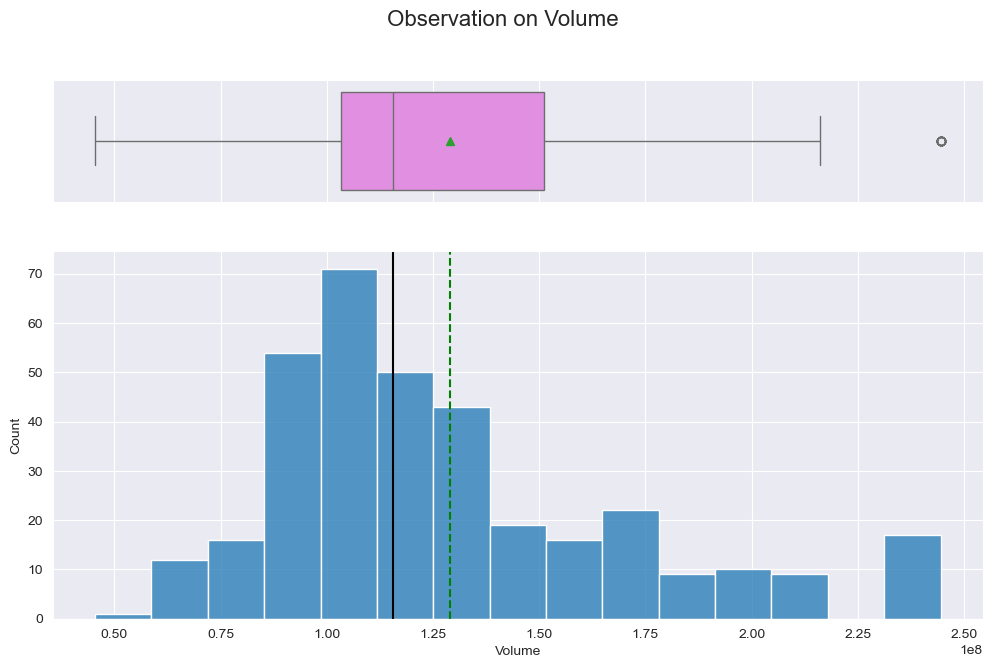

In [22]:
non_category_columns = df.select_dtypes(exclude=["object"]).columns
for i in non_category_columns:
    histogram_boxplot(df, i)

### Bivariate Analysis

* Correlation
* Sentiment Polarity vs Price
* Date vs Price

**Note**: The above points are listed to provide guidance on how to approach bivariate analysis. Analysis has to be done beyond the above listed points to get maximum scores.

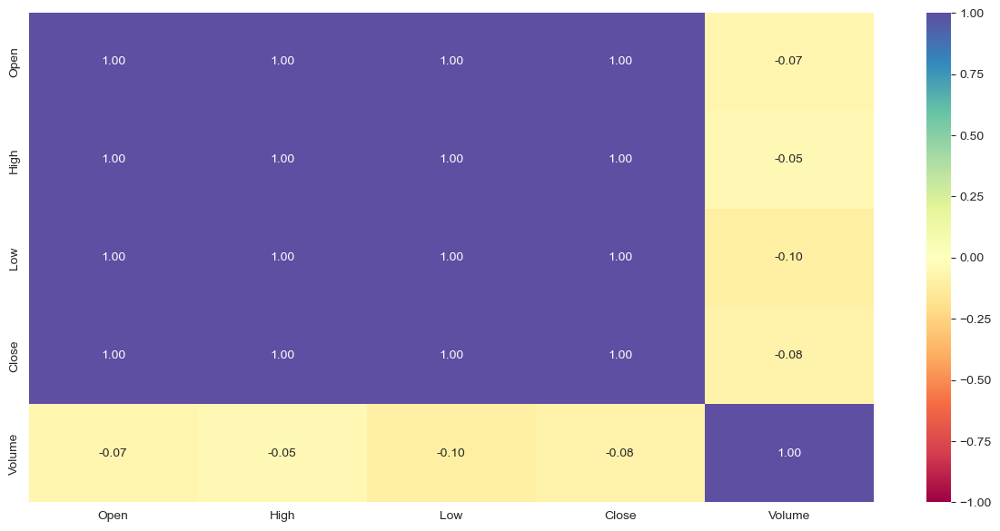

In [23]:
dataCorr = df[df.select_dtypes(include='number').columns.tolist()]
plt.figure(figsize=(15, 7))
sns.heatmap(dataCorr.corr(), annot=True, vmin=-1, vmax=1, fmt=".2f", cmap="Spectral")
plt.show()

#### Observation
We see that the following data:
* Open
* High
* Low
* Close

Are highly correlated.


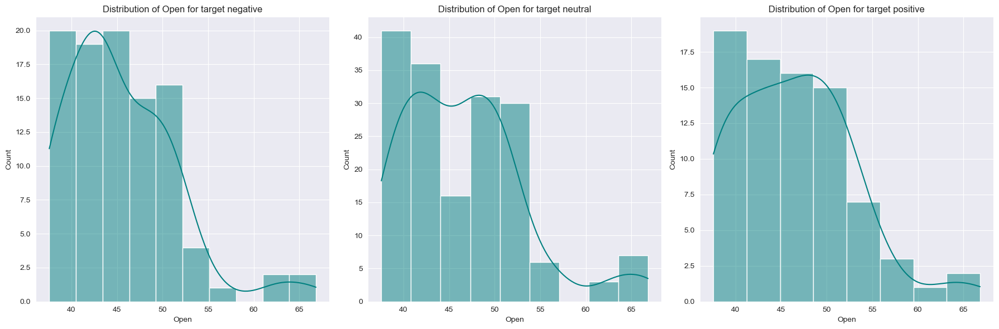

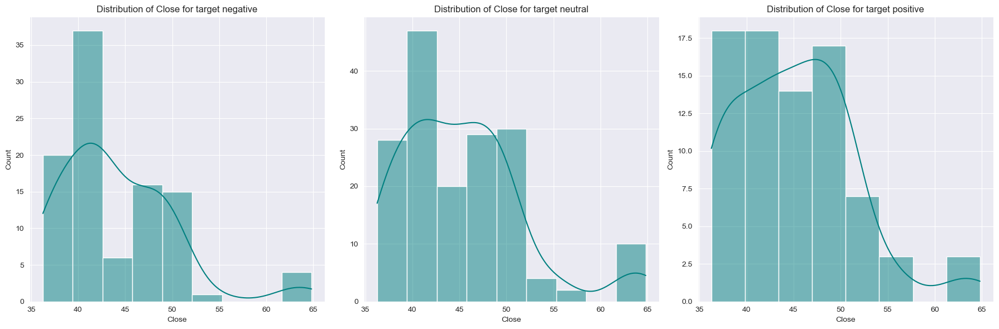

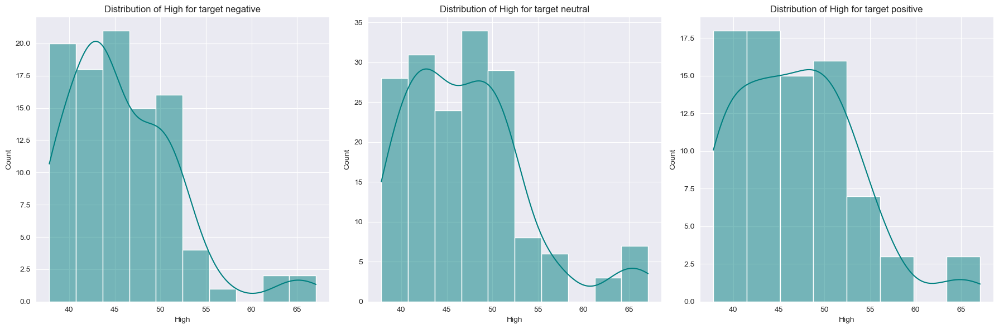

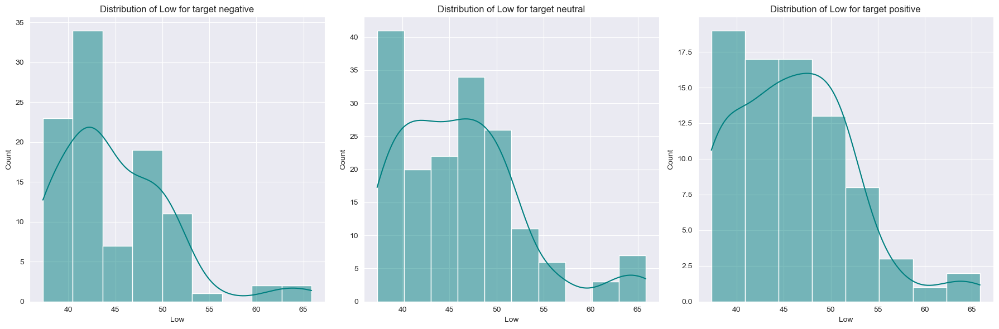

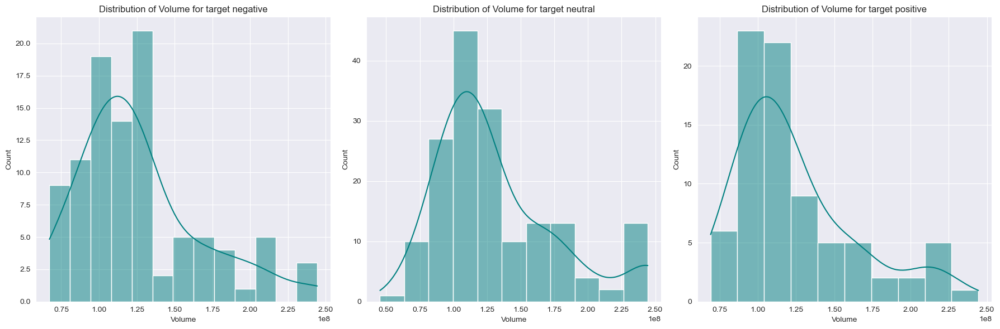

In [24]:
non_category_columns = ['Open', 'Close', 'High', 'Low', 'Volume']
for i in non_category_columns:
    distribution_plot_wrt_target(df, i, 'Label')

Label      negative  neutral  positive  All
Open                                       
All              99      170        80  349
53.474998         2        2         5    9
39.102501         2        4         4   10
43.57            14       10         4   28
37.567501         4        3         4   11
...             ...      ...       ...  ...
43.427502         1        0         0    1
48.3125           0        1         0    1
45.5625           0        2         0    2
46.557499         1        1         0    2
38.549999         0        2         0    2

[71 rows x 4 columns]
------------------------------------------------------------------------------------------------------------------------


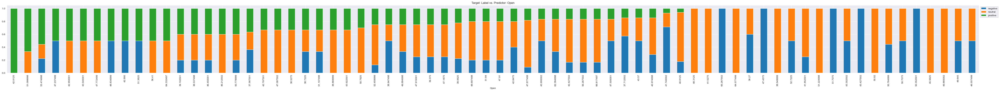

Label      negative  neutral  positive  All
Close                                      
All              99      170        80  349
50.787209         2        2         5    9
36.996128         4        3         4   11
37.051727         2        4         4   10
42.470604        14       10         4   28
...             ...      ...       ...  ...
41.45842          1        4         0    5
49.398319         1        0         0    1
47.417465         0        1         0    1
48.70879          4        5         0    9
49.589897         0        1         0    1

[72 rows x 4 columns]
------------------------------------------------------------------------------------------------------------------------


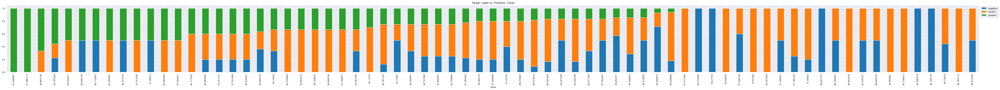

Label      negative  neutral  positive  All
High                                       
All              99      170        80  349
54.5075           2        2         5    9
38.3475           4        3         4   11
43.787498        14       10         4   28
39.182499         2        4         4   10
...             ...      ...       ...  ...
43.75             1        1         0    2
43.825001         1        0         0    1
45.825001         0        2         0    2
47.52             2        0         0    2
42.915001         1        3         0    4

[71 rows x 4 columns]
------------------------------------------------------------------------------------------------------------------------


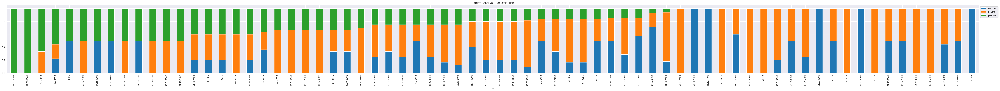

Label      negative  neutral  positive  All
Low                                        
All              99      170        80  349
51.685001         2        2         5    9
37.512501         4        3         4   11
38.154999         2        4         4   10
43.2225          14       10         4   28
...             ...      ...       ...  ...
47.134998         2        0         0    2
43.182499         1        1         0    2
43.2925           1        0         0    1
45.23             0        2         0    2
42.345001         1        4         0    5

[72 rows x 4 columns]
------------------------------------------------------------------------------------------------------------------------


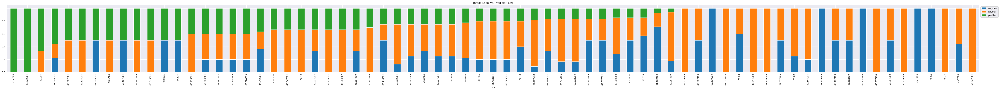

Label      negative  neutral  positive  All
Volume                                     
All              99      170        80  349
216071600         2        2         5    9
114843600         4        3         4   11
103544800        14       10         4   28
121576000         2        4         4   10
...             ...      ...       ...  ...
122278800         3        2         0    5
102785600         0        1         0    1
119284800         0        2         0    2
114430400         0        2         0    2
45448000          0        1         0    1

[72 rows x 4 columns]
------------------------------------------------------------------------------------------------------------------------


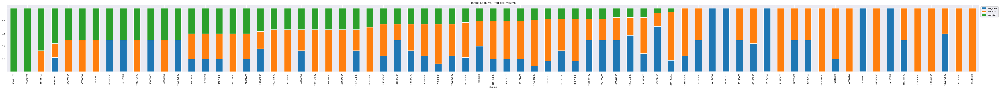

In [25]:
for i in non_category_columns:
    stacked_barplot(df, i, 'Label')

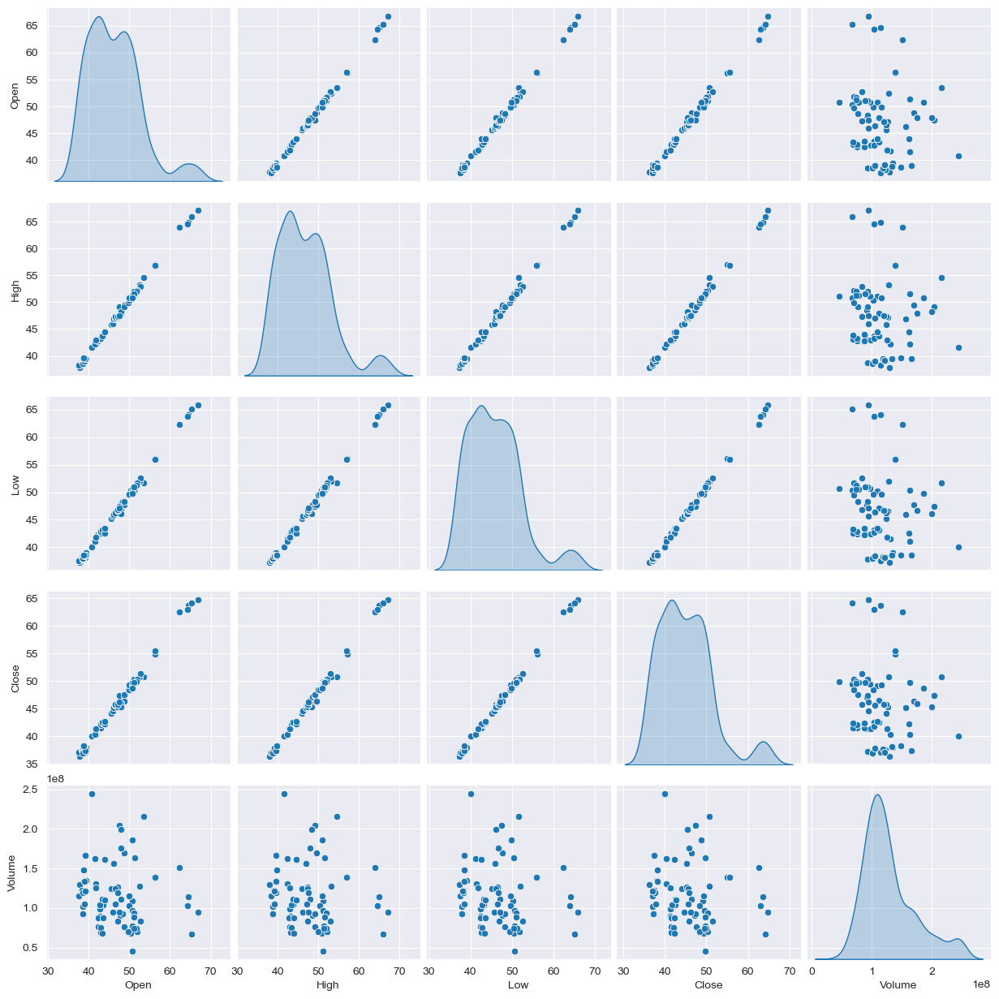

In [26]:
sns.pairplot(data=df, diag_kind="kde")
plt.show()

### Print the volume of transaction per day
As the Low/High, Open/Close is highly correlated, we don't need to print them.

In [27]:
dfc = df.copy()

In [28]:
dfc['Avg_Price'] = (dfc['Open'] + dfc['Close'] + dfc['High'] + dfc['Low']) / 4

In [29]:
dfc.head()

,Date,News,Open,High,Low,Close,Volume,Label,Avg_Price
0,2019-01-02,The tech sector experienced a significant dec...,41.740002,42.244999,41.482498,40.246914,130672400,negative,41.428603
12,2019-01-02,The dollar fell from above 109 to 106.67 afte...,41.740002,42.244999,41.482498,40.246914,130672400,negative,41.428603
11,2019-01-02,"In early Asian trading on Thursday, the Japan...",41.740002,42.244999,41.482498,40.246914,130672400,negative,41.428603
10,2019-01-02,The Australian dollar experienced significant...,41.740002,42.244999,41.482498,40.246914,130672400,neutral,41.428603
9,2019-01-02,Apple Inc. lowered its quarterly sales foreca...,41.740002,42.244999,41.482498,40.246914,130672400,negative,41.428603


In [30]:
stock_daily = dfc.groupby('Date').agg(
    Avg_Volume=('Volume', 'mean'),  # Compute the average of 'Volume'
    Mean_Price_Sum=('Avg_Price', 'mean')
)

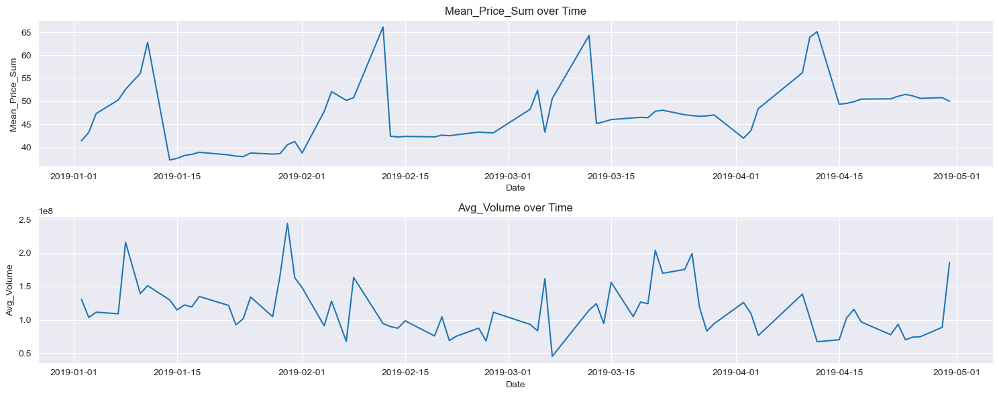

In [31]:
price = ['Mean_Price_Sum', 'Avg_Volume']
fig, axs = plt.subplots(len(price), 1, figsize=(15, 6))

for i, ax in enumerate(axs):
    sns.lineplot(y=stock_daily[price[i]], x=stock_daily.index, ax=ax)
    ax.set_title(f'{price[i]} over Time')

plt.tight_layout()
plt.show()

In [32]:
rev_label = {
    'positive': 1,
    'neutral': 0,
    'negative': -1
}
df['Label'] = df['Label'].map(rev_label)

## Data Preprocessing

Since the data is based on time (with the Date column), I should consider splitting your data chronologically. This will help simulate a real-world scenario where future prices are predicted based on past data.

In [33]:
print(f"Date set starting date: {df['Date'].min()}")
start_date = df['Date'].min()
print(f"Datea set end date: {df['Date'].max()}")
print(f"Duration: {df['Date'].max() - df['Date'].min()}")

Date set starting date: 2019-01-02 00:00:00
Datea set end date: 2019-04-30 00:00:00
Duration: 118 days 00:00:00


In [34]:
train_point = (df['Date'].max() - df['Date'].min())*0.7 # 60% of data
print(f"Train point: {train_point}")
test_val_split = (df['Date'].max() - df['Date'].min())*0.15 # 50% of the remaining %30
print(f"Test-Val Split: {test_val_split}")

Train point: 82 days 14:24:00
Test-Val Split: 17 days 16:48:00


In [35]:
X_train = df[(df['Date'] < start_date + train_point)].reset_index()    #Complete the code to select all rows where the 'Date' is before '2019-04-01'
X_val = df[(df['Date'] >= start_date + train_point) & (df['Date'] < start_date + train_point + test_val_split)].reset_index()    #Complete the code to select all rows where the 'Date' is from '2019-04-01 to '2019-04-16' (excluded)
X_test = df[df['Date'] >= start_date + train_point + test_val_split].reset_index()    #Complete the code to select all rows where the 'Date' is from '2019-04-16' till the end.

In [63]:
X_train.shape, X_val.shape, X_test.shape

((274, 9), (31, 9), (44, 9))

In [64]:
X_train.head()

,index,Date,News,Open,High,Low,Close,Volume,Label
0,0,2019-01-02,The tech sector experienced a significant dec...,41.740002,42.244999,41.482498,40.246914,130672400,-1
1,12,2019-01-02,The dollar fell from above 109 to 106.67 afte...,41.740002,42.244999,41.482498,40.246914,130672400,-1
2,11,2019-01-02,"In early Asian trading on Thursday, the Japan...",41.740002,42.244999,41.482498,40.246914,130672400,-1
3,10,2019-01-02,The Australian dollar experienced significant...,41.740002,42.244999,41.482498,40.246914,130672400,0
4,9,2019-01-02,Apple Inc. lowered its quarterly sales foreca...,41.740002,42.244999,41.482498,40.246914,130672400,-1


## Word Embeddings

### Text Preprocessing
To do the work embeddings we prepare the text with a pipeline that does:
* remove special characters 
* lowercase the text
* remove extra whitespace
* remove stopwords
* perform stemming

In [62]:
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import FunctionTransformer
from nltk.stem.porter import PorterStemmer
import re

# Create a custom transformer for text preprocessing
class TextPreprocessor(BaseEstimator, TransformerMixin):
    def __init__(self):
        self.stopwords = set(stopwords.words('english'))
        self.stemmer = PorterStemmer()

    def remove_special_characters(self, text):
        pattern = '[^A-Za-z0-9]+'
        return re.sub(pattern, ' ', text)

    def to_lowercase(self, text):
        return text.lower()

    def remove_extra_whitespaces(self, text):
        return text.strip()

    def remove_stopwords(self, text):
        return ' '.join([word for word in text.split() if word not in self.stopwords])

    def apply_stemming(self, text):
        return ' '.join([self.stemmer.stem(word) for word in text.split()])

    def preprocess(self, text):
        text = self.remove_special_characters(text)
        text = self.to_lowercase(text)
        text = self.remove_extra_whitespaces(text)
        text = self.remove_stopwords(text)
        return self.apply_stemming(text)

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        return X.apply(self.preprocess)

# Create a pipeline with the custom transformer
pipeline = Pipeline(steps=[
    ('text_preprocessing', FunctionTransformer(lambda x: TextPreprocessor().fit_transform(x), validate=False))
])

In [67]:
X_train['News_clean'] = pipeline.fit_transform(X_train['News'])

In [69]:
X_val['News_clean'] = pipeline.transform(X_val['News'])


In [70]:
X_test['News_clean'] = pipeline.transform(X_test['News'])

In [ ]:
df['News_clean'] = pipeline.transform(df['News'])

### Word2Vec

In [71]:
# Creating a list of all words in our data
X_train_words_list = [item.split(" ") for item in X_train['News_clean'].values]
X_val_words_list = [item.split(" ") for item in X_val['News_clean'].values]
X_test_words_list = [item.split(" ") for item in X_test['News_clean'].values]

In [72]:
# Creating an instance of Word2Vec
vec_size = 300
X_train_model_W2V = Word2Vec(X_train_words_list, vector_size = vec_size, min_count = 1, window=5, workers = 6)
X_val_model_W2V = Word2Vec(X_val_words_list, vector_size = vec_size, min_count = 1, window=5, workers = 6)
X_test_model_W2V = Word2Vec(X_test_words_list, vector_size = vec_size, min_count = 1, window=5, workers = 6)

In [73]:
# Checking the size of the vocabulary
print("Length of the vocabulary for training is", len(list(X_train_model_W2V.wv.key_to_index)))
print("Length of the vocabulary for validation is", len(list(X_val_model_W2V.wv.key_to_index)))
print("Length of the vocabulary for testing is", len(list(X_test_model_W2V.wv.key_to_index)))

Length of the vocabulary for training is 2243
Length of the vocabulary for validation is 635
Length of the vocabulary for testing is 800


In [78]:
# Checking the word embedding of a random word
word = "stock"

In [79]:
X_train_model_W2V.wv[word]

array([ 3.3347420e-03,  4.4971169e-03, -5.7160697e-04,  3.9336528e-03,
       -9.9738951e-05, -4.7151195e-03,  5.8682258e-03,  1.1368321e-02,
        5.7488616e-04, -2.7792406e-04,  2.1081604e-04, -4.1633053e-03,
        1.8523481e-03,  3.2357583e-03, -5.6904443e-03, -2.7186836e-03,
        4.8388601e-03,  1.9855637e-03,  1.7056845e-03, -4.9578198e-03,
       -2.4208415e-03, -1.5561775e-03,  6.5310556e-03,  2.0559598e-03,
        4.5227101e-03,  1.8049529e-03, -7.2156745e-03, -9.1461180e-04,
       -2.1743793e-03, -5.6141214e-03,  4.5204051e-03, -3.3441611e-04,
        1.0492596e-03,  1.0387306e-03, -2.5991572e-03,  2.8315163e-03,
       -1.7902948e-03, -7.9259025e-03, -2.7692048e-03, -3.5548387e-03,
       -8.7468699e-04, -6.9058052e-04,  2.7213881e-03, -6.1114007e-03,
        4.3904274e-03,  8.6962022e-03, -5.6337571e-04, -1.4973157e-03,
       -3.3096117e-03,  3.6068598e-03,  1.0377127e-03, -9.7495876e-04,
       -6.0006059e-03,  2.9731626e-03, -4.1531851e-03,  3.3531403e-03,
      

In [81]:
X_val_model_W2V.wv[word]

array([-2.4194007e-03,  1.5117300e-03,  7.1107241e-04,  2.5016565e-03,
       -1.6155660e-03, -1.6219985e-03, -2.0135390e-03,  1.2819772e-03,
       -1.4873865e-03,  2.8266569e-03, -1.4294150e-03, -3.1430656e-03,
       -1.6248970e-03,  2.1004323e-03, -2.2202670e-03, -1.8275011e-03,
       -2.4154668e-03,  2.0553961e-03,  1.1905023e-03,  9.5842971e-04,
       -1.0774013e-03,  2.0143592e-03, -2.0247577e-03, -6.6906173e-04,
       -1.8900911e-03, -3.1946530e-04, -7.9559657e-04,  2.8312630e-03,
       -1.7967723e-05, -2.9626584e-03, -1.8328868e-03, -2.3284655e-03,
        9.3165244e-04,  3.1781700e-03, -1.9299693e-03,  2.8003254e-03,
        2.8720631e-03, -2.4559668e-03, -3.0009001e-03,  3.1708467e-03,
        2.7221201e-03, -1.5433909e-03, -2.2549452e-03,  2.5633425e-03,
        1.3395685e-03,  2.7526058e-03, -2.4971657e-03, -3.2155968e-03,
        5.0374278e-04, -3.2580870e-03, -1.6213122e-03, -1.1215389e-03,
        3.1764444e-03,  2.9217012e-03, -9.6888753e-04,  2.0609850e-03,
      

In [82]:
X_test_model_W2V.wv[word]

array([ 1.6174503e-03, -1.0795713e-03, -1.4491902e-03,  4.7384904e-04,
       -1.3448589e-03, -1.9973833e-03,  1.1430843e-03,  3.0237243e-03,
       -2.1382892e-03, -3.0433184e-03, -1.1557707e-03,  2.4188862e-03,
       -3.1747306e-03,  3.1739001e-03, -1.8983342e-04,  7.0044131e-04,
       -6.1240909e-04, -1.9348918e-03,  1.1036944e-03,  2.0579873e-03,
       -2.4143930e-03, -4.0251564e-04,  6.2899833e-04,  1.4393934e-03,
        2.5075849e-03, -1.2017584e-03,  2.3204843e-03, -1.8477750e-03,
       -7.5796677e-04,  2.9198620e-03,  1.8217540e-03, -2.8677662e-03,
       -5.1660102e-04, -2.9878004e-03, -5.6470296e-04,  1.9367066e-03,
       -2.4537125e-03,  1.7472233e-03,  2.0393897e-03, -1.2303094e-03,
       -3.3203205e-03, -8.0580811e-04, -8.7236223e-04,  1.1848101e-03,
        3.0342669e-03,  7.9598062e-04, -6.8277738e-04,  1.0145800e-03,
       -2.2964266e-03, -3.5217547e-04, -4.4640474e-04,  3.2537840e-03,
       -2.0166850e-03, -2.3030720e-03,  7.1559229e-04,  9.9321932e-04,
      

In [85]:
# Retrieving the words present in the Word2Vec model's vocabulary
words_training = list(X_train_model_W2V.wv.key_to_index.keys())
words_val = list(X_val_model_W2V.wv.key_to_index.keys())
words_test = list(X_test_model_W2V.wv.key_to_index.keys())

# Retrieving word vectors for all the words present in the model's vocabulary
wvs_training = X_train_model_W2V.wv[words_training].tolist()
wvs_val = X_val_model_W2V.wv[words_val].tolist()
wvs_test = X_test_model_W2V.wv[words_test].tolist()

# Creating a dictionary of words and their corresponding vectors
word_vector_dict_training = dict(zip(words_training, wvs_training))
word_vector_dict_val = dict(zip(words_val, wvs_val))
word_vector_dict_test = dict(zip(words_test, wvs_test))

In [87]:
# compute the average 
def average_vectorizer_Word2Vec(doc, words, word_vector):
    """
    Computes the average vector representation of a sentence using Word2Vec.
    :param doc: 
    :param words: list of words in the model vocabulary
    :param word_vector: dictionary of words and their corresponding vectors
    :return: feature vector
    """
    # Initializing a feature vector for the sentence
    feature_vector = np.zeros((vec_size,), dtype="float64")

    # Creating a list of words in the sentence that are present in the model vocabulary
    words_in_vocab = [word for word in doc.split() if word in words]

    # adding the vector representations of the words
    for word in words_in_vocab:
        feature_vector += np.array(word_vector[word])

    # Dividing by the number of words to get the average vector
    if len(words_in_vocab) != 0:
        feature_vector /= len(words_in_vocab)

    return feature_vector

In [108]:
def vectorized_document(df, target, words, word_vector):
    """
    Vectorized a document using Word2Vec.
    :param df: the datafram to vectorize
    :param target: the target column to vectorize
    :param words: words in the model vocabulary
    :param word_vector: vocabulary of words and their corresponding vectors
    :return: a pd.Datafram
    """
    tmp = pd.DataFrame(df[target].apply(lambda x: average_vectorizer_Word2Vec(x, words, word_vector).tolist()))
    return pd.DataFrame(tmp[target].tolist(),columns=['Feature' + str(i) for i in range(vec_size)])
    

In [109]:
X_train_wv = vectorized_document(X_train, 'News_clean', words_training, word_vector_dict_training)
X_train_wv[['Open', 'Volume']] = X_train[['Open', 'Volume']].astype(float)

In [115]:
X_val_wv = vectorized_document(X_val, 'News_clean', words_val, word_vector_dict_val)
X_val_wv[['Open', 'Volume']] = X_val[['Open', 'Volume']].astype(float)

In [116]:
X_test_wv = vectorized_document(X_test, 'News_clean', words_test, word_vector_dict_test)
X_test_wv[['Open', 'Volume']] = X_val[['Open', 'Volume']].astype(float)

### GloVe

In [117]:
# Converting the Stanford GloVe model vector format to word2vec
from gensim.scripts.glove2word2vec import glove2word2vec
glove_input_file = 'glove.6B.100d.txt'
word2vec_output_file = 'glove.6B.100d.txt.word2vec'
glove2word2vec(glove_input_file, word2vec_output_file)

(400000, 100)

In [118]:
from gensim.models import KeyedVectors
# load the Stanford GloVe model
filename = 'glove.6B.100d.txt.word2vec'
glove_model = KeyedVectors.load_word2vec_format(filename, binary=False)

In [119]:
# Checking the size of the vocabulary
print("Length of the vocabulary is", len(glove_model.index_to_key))

Length of the vocabulary is 400000


In [120]:
word = "stock"
glove_model[word]

array([ 8.6341e-01,  6.9648e-01,  4.5794e-02, -9.5708e-03, -2.5498e-01,
       -7.4666e-01, -2.2086e-01, -4.4615e-01, -1.0423e-01, -9.9931e-01,
        7.2550e-02,  4.5049e-01, -5.9912e-02, -5.7837e-01, -4.6540e-01,
        4.3429e-02, -5.0570e-01, -1.5442e-01,  9.8250e-01, -8.1571e-02,
        2.6523e-01, -2.3734e-01,  9.7675e-02,  5.8588e-01, -1.2948e-01,
       -6.8956e-01, -1.2811e-01, -5.2265e-02, -6.7719e-01,  3.0190e-02,
        1.8058e-01,  8.6121e-01, -8.3206e-01, -5.6887e-02, -2.9578e-01,
        4.7180e-01,  1.2811e+00, -2.5228e-01,  4.9557e-02, -7.2455e-01,
        6.6758e-01, -1.1091e+00, -2.0493e-01, -5.8669e-01, -2.5375e-03,
        8.2777e-01, -4.9102e-01, -2.6475e-01,  4.3015e-01, -2.0516e+00,
       -3.3208e-01,  5.1845e-02,  5.2646e-01,  8.7452e-01, -9.0237e-01,
       -1.7366e+00, -3.4727e-01,  1.6590e-01,  2.7727e+00,  6.5756e-02,
       -4.0363e-01,  3.8252e-01, -3.0787e-01,  5.9202e-01,  1.3468e-01,
       -3.3851e-01,  3.3646e-01,  2.0950e-01,  8.5905e-01,  5.18

In [121]:
# compute average
def average_vectorizer_GloVe(doc, words, word_vector):
    """
    Computes the average vector representation of a sentence using GloVe.
    :param doc: 
    :param words: list of words in the model vocabulary
    :param word_vector: dictionary of words and their corresponding vectors
    :return: vector
    """
    # Initializing a feature vector for the sentence
    feature_vector = np.zeros((vec_size,), dtype="float64")

    # Creating a list of words in the sentence that are present in the model vocabulary
    words_in_vocab = [word for word in doc.split() if word in glove_words]

    # adding the vector representations of the words
    for word in words_in_vocab:
        feature_vector += np.array(glove_word_vector_dict[word])

    # Dividing by the number of words to get the average vector
    if len(words_in_vocab) != 0:
        feature_vector /= len(words_in_vocab)

    return feature_vector

## Sentiment Analysis

## Weekly News Summarization

**Important Note**: It is recommended to run this section of the project independently from the previous sections in order to avoid runtime crashes due to RAM overload.

#### Installing and Importing the necessary libraries

In [ ]:
# Installation for GPU llama-cpp-python
# uncomment and run the following code in case GPU is being used
!CMAKE_ARGS="-DLLAMA_CUBLAS=on" FORCE_CMAKE=1 pip install llama-cpp-python -q

# Installation for CPU llama-cpp-python
# uncomment and run the following code in case GPU is not being used
#!CMAKE_ARGS="-DLLAMA_CUBLAS=off" FORCE_CMAKE=1 pip install llama-cpp-python -q

In [ ]:
# Function to download the model from the Hugging Face model hub
from huggingface_hub import hf_hub_download

# Importing the Llama class from the llama_cpp module
from llama_cpp import Llama

# Importing the library for data manipulation
import pandas as pd

from tqdm import tqdm # For progress bar related functionalities
tqdm.pandas()

#### Loading the data

#### Loading the model

#### Aggregating the data weekly

In [ ]:
data["Date"] = pd.to_datetime(data['Date'])  # Convert the 'Date' column to datetime format.

In [ ]:
# Group the data by week using the 'Date' column.
weekly_grouped = data.groupby(pd.Grouper(key='Date', freq='W'))

In [ ]:
weekly_grouped = weekly_grouped.agg(
    {
        'News': lambda x: ' || '.join(x)  # Join the news values with ' || ' separator.
    }
).reset_index()

print(weekly_grouped.shape)

In [ ]:
weekly_grouped

In [ ]:
# creating a copy of the data
data_1 = weekly_grouped.copy()

#### Summarization

**Note**:

- The model is expected to summarize the news from the week by identifying the top three positive and negative events that are most likely to impact the price of the stock.

- As an output, the model is expected to return a JSON containing two keys, one for Positive Events and one for Negative Events.

For the project, we need to define the prompt to be fed to the LLM to help it understand the task to perform. The following should be the components of the prompt:

1. **Role**: Specifies the role the LLM will be taking up to perform the specified task, along with any specific details regarding the role

  - **Example**: `You are an expert data analyst specializing in news content analysis.`

2. **Task**: Specifies the task to be performed and outlines what needs to be accomplished, clearly defining the objective

  - **Example**: `Analyze the provided news headline and return the main topics contained within it.`

3. **Instructions**: Provides detailed guidelines on how to perform the task, which includes steps, rules, and criteria to ensure the task is executed correctly

  - **Example**:

```
Instructions:
1. Read the news headline carefully.
2. Identify the main subjects or entities mentioned in the headline.
3. Determine the key events or actions described in the headline.
4. Extract relevant keywords that represent the topics.
5. List the topics in a concise manner.
```

4. **Output Format**: Specifies the format in which the final response should be structured, ensuring consistency and clarity in the generated output

  - **Example**: `Return the output in JSON format with keys as the topic number and values as the actual topic.`

**Full Prompt Example**:

```
You are an expert data analyst specializing in news content analysis.

Task: Analyze the provided news headline and return the main topics contained within it.

Instructions:
1. Read the news headline carefully.
2. Identify the main subjects or entities mentioned in the headline.
3. Determine the key events or actions described in the headline.
4. Extract relevant keywords that represent the topics.
5. List the topics in a concise manner.

Return the output in JSON format with keys as the topic number and values as the actual topic.
```

**Sample Output**:

`{"1": "Politics", "2": "Economy", "3": "Health" }`

##### Utility Functions

In [ ]:
# defining a function to parse the JSON output from the model
def extract_json_data(json_str):
    import json
    try:
        # Find the indices of the opening and closing curly braces
        json_start = json_str.find('{')
        json_end = json_str.rfind('}')

        if json_start != -1 and json_end != -1:
            extracted_category = json_str[json_start:json_end + 1]  # Extract the JSON object
            data_dict = json.loads(extracted_category)
            return data_dict
        else:
            print(f"Warning: JSON object not found in response: {json_str}")
            return {}
    except json.JSONDecodeError as e:
        print(f"Error parsing JSON: {e}")
        return {}

##### Defining the response function

In [ ]:
#Defining the response function
def response_mistral_1(prompt, news):
    model_output = llm(
      f"""
      [INST]
      {prompt}
      News Articles: {news}
      [/INST]
      """,
      max_tokens=_____, #Complete the code to set the maximum number of tokens the model should generate for this task.
      temperature=_____, #Complete the code to set the value for temperature.
      top_p=_____, #Complete the code to set the value for top_p
      top_k=_____, #Complete the code to set the value for top_k
      echo=False,
    )

    final_output = model_output["choices"][0]["text"]

    return final_output

##### Checking the model output on a sample

**Note**: Use this section to test out the prompt with one instance before using it for the entire weekly data.

##### Checking the model output on the weekly data

##### Formatting the model output

## **Conclusions and Recommendations**

-




<font size=6 color='blue'>Power Ahead</font>
___